# Aprendiendo a caminar con PPO

ESTUDIANTES: `MANUELA LARREA GÓMEZ`

![Bipedal Walker](https://albarji-labs-materials.s3.eu-west-1.amazonaws.com/bipedalWalker.png)

En esta práctica vamos a resolver el problema de optimizar un robot simulado para que sea capaz de caminar sobre un terreno de la forma más eficiente posible. Para ello utilizaremos el algoritmo Proximal Policy Optimization (PPO).

## Instrucciones

A lo largo del notebook encontrarás celdas que debes rellenar con tu propio código. Sigue las instrucciones del notebook y presta atención a los siguientes iconos:

<img src="https://albarji-labs-materials.s3-eu-west-1.amazonaws.com/question.png" height="80" width="80" style="float: right;"/>

***

<font color=#ad3e26>
Deberás resolver el ejercicio escribiendo tu propio código o respuesta en la celda inmediatamente inferior.
    <b>La nota máxima que puede obtenerse con esta clase de ejercicios es de 7 sobre 10.</b>
</font>

***

<img src="https://albarji-labs-materials.s3-eu-west-1.amazonaws.com/exclamation.png" height="80" width="80" style="float: right;"/>

***
<font color=#2655ad>
Esto es una pista u observación de utilidad que puede ayudarte a resolver el ejercicio. Presta atención a estas pistas para comprender el ejercicio en mayor profundidad.
</font>

***

<img src="https://albarji-labs-materials.s3-eu-west-1.amazonaws.com/pro.png" height="80" width="80" style="float: right;"/>

***
<font color=#259b4c>
Este es un ejercicio avanzado que te puede ayudar a profundizar en el tema, y a conseguir una calificación más alta. <b>Resolviendo esta clase de ejercicios puedes llegar conseguir hasta 3 puntos sobre 10.</b> ¡Buena suerte!</font>

***

## Preliminares

En primer lugar vamos a instalar las librerías necesarias para ejecutar PPO, así que como para correr el entorno de simulación.

In [1]:
!apt install swig
!pip install box2d box2d-kengz
!pip install stable-baselines3[extra] gymnasium[box2d]

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  swig4.0
Suggested packages:
  swig-doc swig-examples swig4.0-examples swig4.0-doc
The following NEW packages will be installed:
  swig swig4.0
0 upgraded, 2 newly installed, 0 to remove and 45 not upgraded.
Need to get 1,116 kB of archives.
After this operation, 5,542 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 swig4.0 amd64 4.0.2-1ubuntu1 [1,110 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 swig all 4.0.2-1ubuntu1 [5,632 B]
Fetched 1,116 kB in 0s (2,797 kB/s)
Selecting previously unselected package swig4.0.
(Reading database ... 121913 files and directories currently installed.)
Preparing to unpack .../swig4.0_4.0.2-1ubuntu1_amd64.deb ...
Unpacking swig4.0 (4.0.2-1ubuntu1) ...
Selecting previously unselected package swig.
Preparing to unpack .../swig_4.0.2-1ubu

También vamos a cargar la extensión de Colab que permite visualizar dashboards de TensorBoard en este notebook.

In [ ]:
%load_ext tensorboard

Arrancamos la interfaz de tensorboard para monitorizar la carpeta `runs`

In [ ]:
%tensorboard --logdir "runs"

<IPython.core.display.Javascript object>

## Enseñando a un robot a andar

El entorno sobre el que vamos a trabajar es [Bipedal Walker](https://gymnasium.farama.org/environments/box2d/bipedal_walker/). En él, un robot simulado debe atravesar un terreno irregular de la forma más eficiente posible. Como observaciones, el robot dispone de:
- Módulo de la velocidad de la cabeza.
- Vector de velocidad angular.
- Componente de velocidad horizontal.
- Componente de velocidad vertical.
- Posición de las juntas.
- Módulo de la velocidad angular de las juntas.
- Contacto de las piernas con el suelo.
- 10 mediciones de distancia simulando un LIDAR.

El robot tiene permitidas 4 acciones continuas, en el rango `[-1, 1]`, que representan la velocidad del motor que aplicamos en las 4 juntas disponibles: dos en la "cintura" y dos en las "rodillas" del robot.

Se obtiene recompensa a medida que el robot se mueve hacia la derecha. Si la cabeza del robot robot toca el suelo, sufre una penalización de `-100` puntos y el episodio termina. Aplicar fuerza a los motores supone una pequeña penalización, por lo que un robot más eficiente conseguirá más recompensa al desplazarse. El episodio termina sin penalización si el robot alcanza el final del recorrido.

<img src="https://albarji-labs-materials.s3-eu-west-1.amazonaws.com/question.png" height="80" width="80" style="float: right;"/>

***

<font color=#ad3e26>
Entrena un agente usando <a href=https://stable-baselines3.readthedocs.io/en/master/modules/ppo.html>PPO</a> que consiga al menos 250 puntos de recompensa en promedio en una evaluación de 10 episodios.

Deberás entregar tanto este notebook con la solución, como un vídeo que muestre al agente corriendo y finalizando el recorrido.
</font>

***

<img src="https://albarji-labs-materials.s3-eu-west-1.amazonaws.com/exclamation.png" height="80" width="80" style="float: right;"/>

***
<font color=#2655ad>
Algunos consejos para lograr esto:
    <ul>
        <li>No necesitas usar GPU para resolver esta práctica. El entorno es lo suficientemente sencillo como para ejecutar rápidamente en CPU.</li>
        <li>Comienza con entrenamientos de 100.000 timesteps, y ve probando a modificar diferentes parámetros de PPO y de la construcción del entorno para observar con cuáles consigues obtener mejor reward al final del entrenamiento.</li>
        <li>El primer parámetro a optimizar debería ser el número de entornos vectorizados, ya que esto te permite entrenar más rápido. Ten en cuenta que PPO realiza un paso de aprendizaje cada vez que recoge <it>n_steps * n_envs</it> muestras, por lo que si se aumenta el número de entornos el aprendizaje puede volverse más lento. Para mantener un buen ritmo de aprendizaje se recomienda ajustar el parámetro <it>n_steps</it> según el número de entornos, por ejemplo a <it>n_steps=2048//n_envs</it>.
        <li>La arquitectura de la red neuronal también es un parámetro relevante a optimizar. Prueba modificando el número de capas y el número de neuronas por capa, empezando de menos a más.</li>
        <li>El factor de entropía de PPO (<it>ent_coef</it>), que gobierna su cantidad de exploración, también puede aportar mejoras si se ajusta adecuadamente. Se recomienda empezar por valores muy pequeños (ej. 1e-4) e ir subiendo en múltiplos de 10.</li>
        <li>Una vez optimizados todos estos parámetros puedes probar a aumentar el número de timesteps de entrenamiento y ver si alcanzas la recompensa objetivo en evaluación.</li>
    </ul>
</font>

***

<img src="https://albarji-labs-materials.s3-eu-west-1.amazonaws.com/pro.png" height="80" width="80" style="float: right;"/>

***
<font color=#259b4c>
Se considera que este entorno ha sido completamente resuelto si eres capaz de obtener 300 puntos de recompensa. ¿Puedes crear un agente que lo consiga?
</font>

***

In [2]:
# Importación de librerías
import gymnasium as gym
from stable_baselines3 import PPO
from stable_baselines3.common.vec_env import VecVideoRecorder
from stable_baselines3.common.env_util import make_vec_env, DummyVecEnv
from stable_baselines3.common.evaluation import evaluate_policy
from stable_baselines3.common.utils import set_random_seed


from moviepy.video.fx.all import speedx
from moviepy.editor import VideoFileClip

from pathlib import Path
from IPython.display import Image, display


from functools import partial
from stable_baselines3.common.logger import configure
from statistics import mean
import os

/usr/local/lib/python3.10/dist-packages/skimage/util/dtype.py:27: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  np.bool8: (False, True),
/usr/local/lib/python3.10/dist-packages/moviepy/video/fx/painting.py:7: DeprecationWarning: Please use `sobel` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  from scipy.ndimage.filters import sobel


Iniciamos fijando la semilla

In [3]:
SEED = 42
set_random_seed(SEED)


  and should_run_async(code)



In [4]:
# Creamos la función para generar el vídeo
def record_video(env, model, prefix, steps=1000):
  """Generates a video of a reinforcement learning model interacting with an environment.

  Arguments:
    env: name of the environment (str) or callable generating the environment
    model: reinforcement learning model
    steps: number of steps to render
  """
  video_folder = "videos/"

  if callable(env):
      envfun = partial(env, render_mode="rgb_array")
  else:
      envfun = lambda: gym.make(env, render_mode="rgb_array")
  vec_env = DummyVecEnv([envfun])

  obs = vec_env.reset()



  # Record the video starting at the first step
  vec_env = VecVideoRecorder(vec_env, video_folder,
                        record_video_trigger=lambda x: x == 0, video_length=steps,
                        name_prefix=prefix)

  vec_env.reset()
  for _ in range(steps + 1):
      action = [model.predict(obs[0])[0]]
      obs, _, _, _ = vec_env.step(action)
  # Save the video
  vec_env.close()

# Creamos una función para convertir estos vídeos en gifs para su visualización dentro del notebook.
def mp4_to_gif(input_path, output_path, start_time=0, end_time=20, resize_factor=1):

    if not os.path.exists('gif'):
        os.makedirs('gif')

    clip = VideoFileClip(input_path)

    if end_time:
        clip = clip.subclip(start_time, end_time)
    else:
        clip = clip.subclip(start_time)

    clip = speedx(clip, factor=3)

    if resize_factor != 1:
        clip = clip.resize(resize_factor)

    output_path = "gif/" + output_path
    # Write the result to a GIF file
    clip.write_gif(output_path, fps=clip.fps)

    clip.close()

def display_gif(path):
    gifPath = Path(path)
    # Display GIF in Jupyter, CoLab, IPython
    with open(gifPath, 'rb') as f:
        display(Image(data=f.read(), format='png'))


In [5]:
# Creamos el directorio de logs
log_dir = "./runs/"
os.makedirs(log_dir, exist_ok=True)

## Modelo 1: El punto de partida
Partimos de un modelo sencillo con 4 entornos y el resto de parámetros por defecto según lo descrito en la librería de [stable-baselines](https://stable-baselines3.readthedocs.io/en/master/modules/ppo.html). El modelo consta de:

* 4 environments
* 2048 // 4 steps
* 100000 timesteps

In [34]:
# Creamos el ambiente
n_envs = 4
vec_env = make_vec_env("BipedalWalker-v3", n_envs = 4, seed=SEED)


In [35]:
# Creamos el modelo PPO
model = PPO("MlpPolicy", vec_env, n_steps = 2048//n_envs, tensorboard_log=log_dir, seed=SEED)

In [36]:
# Entrenamos el modelo
model.learn(total_timesteps=100000, log_interval = 10)

In [37]:
# Guardamos el modelo
model.save(os.path.join(log_dir, "ppo_bipedalwalker1"))


In [38]:
# Evaluamos
mean_reward, std_reward = evaluate_policy(model, vec_env, n_eval_episodes=10)
print(f'Mean Reward: {mean_reward} +/- {std_reward}')

Mean Reward: -59.8152412 +/- 12.237160118984027


In [ ]:
# Renderizamos el vídeo
record_video("BipedalWalker-v3", model, prefix="model_1")

Saving video to /content/videos/model_1-step-0-to-step-1000.mp4
Moviepy - Building video /content/videos/model_1-step-0-to-step-1000.mp4.
Moviepy - Writing video /content/videos/model_1-step-0-to-step-1000.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/model_1-step-0-to-step-1000.mp4


MoviePy - Building file gif/model1.gif with imageio.


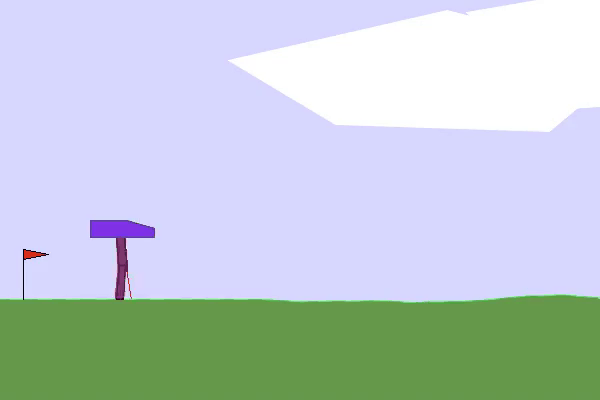

In [ ]:
mp4_to_gif("/content/videos/model_1-step-0-to-step-1000.mp4", "model1.gif")
display_gif("/content/gif/model1.gif")


Tenemos un reward promedio de -59.81, con una desviación estándar de +/- 12.29,  y el caminante tiene un paso bastante curioso.

Modifiquemos los parámetros y volvamos a entrenar.

## Model 2: Ajustando el número de entornos


Comenzaremos con una mayor cantidad de entornos para ver si mejora la velocidad del entrenamiento y la recompensa final.

Aumentamos al doble de entornos. El resto de parámetros los dejamos constantes.

Modelo 2.1: Aumentando los entornos

In [ ]:
n_envs = 8
vec_env = make_vec_env("BipedalWalker-v3", n_envs=n_envs)
n_steps = 2048 // n_envs

In [ ]:
model_2 = PPO("MlpPolicy", vec_env, n_steps=n_steps, tensorboard_log=log_dir)
model_2.learn(total_timesteps=100000, log_interval=10)
model_2.save(os.path.join(log_dir, "ppo_bipedalwalker2"))


In [ ]:
# Evaluamos
mean_reward_2, std_reward_2 = evaluate_policy(model_2, vec_env, n_eval_episodes=10)
print(f'Mean Reward: {mean_reward_2} +/- {std_reward_2}')

Mean Reward: -115.7177201 +/- 22.90682790412311


In [ ]:
record_video("BipedalWalker-v3", model_2, prefix="model2")

Saving video to /content/videos/model2-step-0-to-step-1000.mp4
Moviepy - Building video /content/videos/model2-step-0-to-step-1000.mp4.
Moviepy - Writing video /content/videos/model2-step-0-to-step-1000.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/model2-step-0-to-step-1000.mp4


In [ ]:
mp4_to_gif("./videos/model2-step-0-to-step-1000.mp4", "./model2.gif")

MoviePy - Building file gif/./model2.gif with imageio.


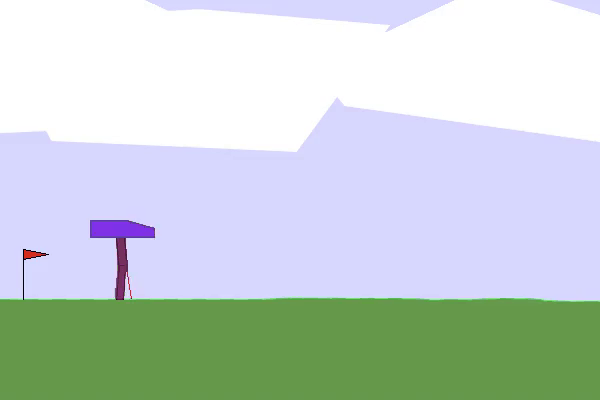

In [ ]:
display_gif("./gif/model2.gif")

Resultado inesperado. La recompensa promedio disminiyó. Aumentar la cantidad de entornos no mejoró el rendimiento del modelo. Procedamos con otra modificación de parámetros.



## Modelo 3: Ajuste de la arquitectura de la red neuronal

In [ ]:
n_envs = 4
vec_env = make_vec_env("BipedalWalker-v3", n_envs=n_envs, seed=SEED)

n_steps = 2048 // n_envs

Definamos una arquitectura de red neuronal propia.
Iniciamos con un arquitectura de 2 capas y 64 neuronas

In [ ]:
from stable_baselines3.common.policies import ActorCriticPolicy
from torch import nn
import torch as th

class CustomPolicy(ActorCriticPolicy):
    def __init__(self, *args, **kwargs):
        super(CustomPolicy, self).__init__(*args, **kwargs)

        self.net_arch = [
            {"pi": [64, 64], "vf": [64, 64]}
        ]

        # Policy network
        self.pi_net = nn.Sequential(
            nn.Linear(self.features_dim, 64),
            nn.ReLU(),
            nn.Linear(64, 64),
            nn.ReLU()
        )

        # Value network
        self.vf_net = nn.Sequential(
            nn.Linear(self.features_dim, 64),
            nn.ReLU(),
            nn.Linear(64, 64),
            nn.ReLU()
        )

    def forward(self, obs: th.Tensor, deterministic: bool = False):
        features = self.extract_features(obs)
        latent_pi = self.pi_net(features)
        latent_vf = self.vf_net(features)
        distribution = self._get_action_dist_from_latent(latent_pi)
        actions = distribution.get_actions(deterministic=deterministic)
        value = self.value_net(latent_vf)
        log_prob = distribution.log_prob(actions)
        return actions, value, log_prob

    def _predict(self, observation: th.Tensor, deterministic: bool = False):
        return self.forward(observation, deterministic=deterministic)[0]


In [ ]:
model3 = PPO(CustomPolicy, vec_env, n_steps=n_steps, tensorboard_log=log_dir, seed=SEED)

model3.learn(total_timesteps=100000, log_interval=10)

model3.save(os.path.join(log_dir, "ppo_bipedalwalker3"))


In [ ]:
# Evaluamos
mean_reward_3, std_reward_3 = evaluate_policy(model3, vec_env, n_eval_episodes=10)
print(f'Mean Reward: {mean_reward_3} +/- {std_reward_3}')

Mean Reward: -100.1977372 +/- 0.11762179555320403


In [ ]:
record_video("BipedalWalker-v3", model3, prefix="model3")
mp4_to_gif("./videos/model3-step-0-to-step-1000.mp4", "./model3.gif")

Saving video to /content/videos/model3-step-0-to-step-1000.mp4
Moviepy - Building video /content/videos/model3-step-0-to-step-1000.mp4.
Moviepy - Writing video /content/videos/model3-step-0-to-step-1000.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/model3-step-0-to-step-1000.mp4
MoviePy - Building file gif/./model3.gif with imageio.


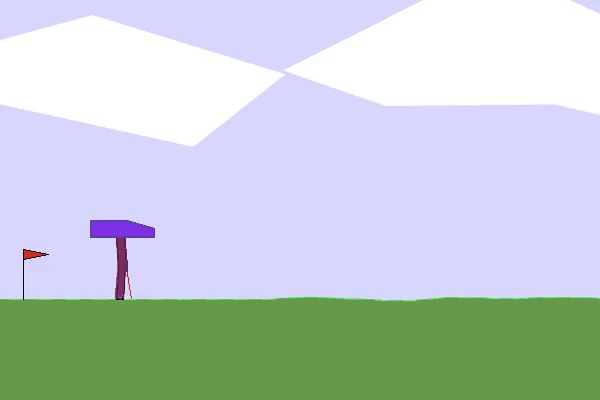

In [ ]:
display_gif("./gif/model3.gif")

Si bien la recompensa mejoró levemente, no lo suficiente para justificar seguir utilizando esta arquitectura.

Procedamos con otra modificación, esta vez ajustando el coeficiente de entropía (ent_coef).

## Modelo 4: Aumentando el coeficiente de *entropía*

El coeficiente de entropía es un regularizador. Una política tiene entropía máxima cuando todas las políticas son igualmente probables y mínima cuando la probabilidad de acción de la política es dominante. El coeficiente de entropía se multiplica por la entropía máxima posible y se suma a la pérdida. Esto ayuda a evitar la convergencia prematura de una probabilidad de acción que domina la política e impide la exploración.

In [ ]:
n_envs = 4
vec_env = make_vec_env("BipedalWalker-v3", n_envs=n_envs, seed=SEED)
n_steps = 2048 // n_envs

In [ ]:
model4 = PPO("MlpPolicy", vec_env, n_steps=n_steps, ent_coef=0.0001, tensorboard_log=log_dir)

model4.learn(total_timesteps=100000, log_interval=10)

model4.save(os.path.join(log_dir, "ppo_bipedalwalker4"))


In [ ]:
# Evaluamos
mean_reward_4, std_reward_4 = evaluate_policy(model4, vec_env, n_eval_episodes=10)
print(f'Mean Reward: {mean_reward_4} +/- {std_reward_4}')

Mean Reward: -104.2500812 +/- 0.18599696443963717


In [ ]:
record_video("BipedalWalker-v3", model3, prefix="model4")
mp4_to_gif("./videos/model4-step-0-to-step-1000.mp4", "./model4.gif")

Saving video to /content/videos/model4-step-0-to-step-1000.mp4
Moviepy - Building video /content/videos/model4-step-0-to-step-1000.mp4.
Moviepy - Writing video /content/videos/model4-step-0-to-step-1000.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/model4-step-0-to-step-1000.mp4
MoviePy - Building file gif/./model4.gif with imageio.


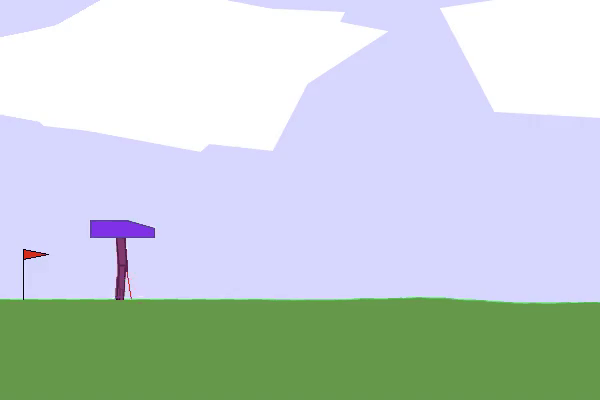

In [ ]:
display_gif("./gif/model4.gif")

Aumentar el coeficiente de entropía empeoró nuestro modelo. El empujarle a explorar fue contraproducente.

 Intentemos aumentando en radio de aprendizaje:

## Modelo 5: Aumentando el radio de aprendizaje

El learning rate determina el tamaño del paso en cada iteración mientras avanza hacia un mínimo de la función de pérdida. Básicamente, controla cuánto cambiar el modelo en respuesta al error estimado cada vez que se actualizan las ponderaciones del modelo.

Por defecto, stable-baselines tiene un learning_rate = 0.0003. Aumentamos levemente a 0.0004 para observar el comportamiento del modelo:

In [6]:
n_envs = 4
vec_env = make_vec_env("BipedalWalker-v3", n_envs=n_envs, seed=SEED)
n_steps = 2048 // n_envs

In [7]:
model5 = PPO("MlpPolicy", vec_env, n_steps=n_steps, learning_rate=0.0004, tensorboard_log=log_dir, seed=SEED)
model5.learn(total_timesteps=100000, log_interval=10)
model5.save(os.path.join(log_dir, "ppo_bipedalwalker5"))


In [9]:
# Evaluamos
mean_reward_5, std_reward_5 = evaluate_policy(model5, vec_env, n_eval_episodes=10)
print(f'Mean Reward: {mean_reward_5} +/- {std_reward_5}')

  and should_run_async(code)



Mean Reward: 148.36919389999997 +/- 5.604317288530378


La recompensa promedio aumento muchísimo!
Sigamos jugando con más parámetros



## Modelo 6: Aumentemos el tamaño del lote.

El tamaño del lote es uno de los hiperparámetros más importantes en el entrenamiento de aprendizaje profundo, representa la cantidad de muestras utilizadas en un paso hacia adelante y hacia atrás a través de la red y tiene un impacto directo en la precisión y la eficiencia computacional del proceso de entrenamiento.

Aumentemos el tamaño del lote de 64 a 128 y observemos si el modelo obtiene mejores resultados:

In [10]:
n_envs = 4
vec_env = make_vec_env("BipedalWalker-v3", n_envs=n_envs, seed = SEED)
n_steps = 2048 // n_envs

In [11]:
model6 = PPO(
    policy='MlpPolicy',
    env=vec_env,
    n_steps= 2048 // n_envs,
    learning_rate=0.0004,
    batch_size = 128,
    tensorboard_log=log_dir,
    seed = SEED
)

model6.learn(total_timesteps=100000, log_interval=10)

model6.save(os.path.join(log_dir, "ppo_bipedalwalker6"))


In [12]:
# Evaluamos
mean_reward_6, std_reward_6 = evaluate_policy(model6, vec_env, n_eval_episodes=10)
print(f'Mean Reward: {mean_reward_6} +/- {std_reward_6}')

Mean Reward: 71.2720534 +/- 2.8262695998822256


Parece que al aumentar el tamaño del lote obtenemos un rendimiento peor.

## Modelo 7: Parámetro Gamma

Empecemos a jugar más con los otros parámetros expuestos en la librería de stable-baselines.

In [13]:
n_envs = 4
vec_env = make_vec_env("BipedalWalker-v3", n_envs=n_envs, seed = SEED)

Aumentamos ligeramente el gamma del defecto 0.99 a 0.999

In [14]:
model7 = PPO(
    policy='MlpPolicy',
    env=vec_env,
    n_steps= 2048 // n_envs,
    gamma = 0.999,
    learning_rate=0.0004,
    tensorboard_log=log_dir,
    seed = SEED
)

model7.learn(total_timesteps=100000, log_interval=10)

model7.save(os.path.join(log_dir, "ppo_bipedalwalker7"))


  and should_run_async(code)



In [19]:
# Evaluamos
mean_reward_7, std_reward_7 = evaluate_policy(model7, vec_env, n_eval_episodes=10)
print(f'Mean Reward: {mean_reward_7} +/- {std_reward_7}')

Mean Reward: 86.69985259999999 +/- 86.12514877214429


Disminuyó con respecto a nuestro mejor modelo.

Modelo 7.5: Disminuyendo el Gamma

In [20]:
model7_5 = PPO(
    policy='MlpPolicy',
    env=vec_env,
    n_steps= 2048 // n_envs,
    gamma = 0.9,
    learning_rate=0.0004,
    tensorboard_log=log_dir,
    seed = SEED
)

model7_5.learn(total_timesteps=100000, log_interval=10)

model7_5.save(os.path.join(log_dir, "ppo_bipedalwalker7_5"))


In [21]:
# Evaluamos
mean_reward_7_5, std_reward_7_5 = evaluate_policy(model7_5, vec_env, n_eval_episodes=10)
print(f'Mean Reward: {mean_reward_7_5} +/- {std_reward_7_5}')

Mean Reward: -91.7253053 +/- 10.889749073977962


Definitivamente disminuir el gamma no fue acertado para esta ocasión.

## Modelo 8: Aumentando el número de lotes

In [15]:
n_envs = 4
vec_env = make_vec_env("BipedalWalker-v3", n_envs=n_envs, seed = SEED)


In [16]:
model8 = PPO(
    policy='MlpPolicy',
    env=vec_env,
    n_steps= 2048 // n_envs,
    learning_rate=0.0004,
    tensorboard_log=log_dir,
    batch_size = 128,
    seed = SEED,
)

model8.learn(total_timesteps=100000, log_interval=10)

model8.save(os.path.join(log_dir, "ppo_bipedalwalker8"))


In [17]:
# Evaluamos
mean_reward_8, std_reward_8 = evaluate_policy(model8, vec_env, n_eval_episodes=10)
print(f'Mean Reward: {mean_reward_8} +/- {std_reward_8}')

Mean Reward: 71.2720534 +/- 2.8262695998822256


Aún no superamos nuestro modelo 5

## Modelo 9: Aumentando el número de epochs

In [ ]:
n_envs = 4
vec_env = make_vec_env("BipedalWalker-v3", n_envs=n_envs, seed = SEED)

n_steps = 2048 // n_envs

model9 = PPO(
    policy='MlpPolicy',
    env=vec_env,
    n_steps= 2048 // n_envs,
    learning_rate=0.0004,
    tensorboard_log=log_dir,
    seed = SEED,
    n_epochs = 20
)

model9.learn(total_timesteps=100000, log_interval=10)

model9.save(os.path.join(log_dir, "ppo_bipedalwalker_9"))

In [23]:
mean_reward_9, std_reward_9 = evaluate_policy(model9, vec_env, n_eval_episodes=10)
print(f'Mean Reward: {mean_reward_9} +/- {std_reward_9}')

  and should_run_async(code)



Mean Reward: 138.27054779999997 +/- 7.720433594014249


El modelo no parece mejorar mucho aumentando el número de epochs, y esto aumenta el tiempo de entrenamiento, así que podemos descartarlo

Intetemos tomar el modelo 5 y aumentar el time_step

## Modelo 10: 200.000 timesteps

In [24]:
n_envs = 4
vec_env = make_vec_env("BipedalWalker-v3", n_envs=n_envs, seed = SEED)

model10 = PPO(
    policy='MlpPolicy',
    env=vec_env,
    n_steps= 2048 // n_envs,
    learning_rate=0.0004,
    tensorboard_log=log_dir,
    seed = SEED
)

model10.learn(total_timesteps=200000, log_interval=10)

model10.save(os.path.join(log_dir, "ppo_bipedalwalker10"))


In [28]:
mean_reward_10, std_reward_10 = evaluate_policy(model10, vec_env, n_eval_episodes=10)
print(f'Mean Reward: {mean_reward_10} +/- {std_reward_10}')

Mean Reward: 207.04815539999998 +/- 9.881409134642428


Definitivamente aumentar el número de timesteps aumenta el mean reward. Que pasaría si lo aumentamos más?

## Modelo 11: 1.000.000 timesteps

In [40]:
n_envs = 4
vec_env = make_vec_env("BipedalWalker-v3", n_envs=n_envs, seed = SEED)

model11 = PPO(
    policy='MlpPolicy',
    env=vec_env,
    n_steps= 2048 // n_envs,
    learning_rate=0.0004,
    tensorboard_log=log_dir,
    seed = SEED
)

model11.learn(total_timesteps=1_000_000, log_interval=10)

model11.save(os.path.join(log_dir, "ppo_bipedalwalker11"))


In [41]:
mean_reward_11, std_reward_11 = evaluate_policy(model11, vec_env, n_eval_episodes=10)
print(f'Mean Reward: {mean_reward_11} +/- {std_reward_11}')

Mean Reward: 180.32631859999998 +/- 132.25301662354542


A pesar de aumentar los timesteps, el modelo se volvió más inestable, con un promedio menor y una desviación estándar muchísimo más alta.

Intentemos implementar un learning rate dinámico, el cual disminuye el learning rate con el tiempo. Esto puede ayudar a que el modelo converja de manera más estable durante períodos de entrenamiento más largos.

## Modelo final: Learning rate dinámico



In [42]:
# Creamos el ambiente
n_envs = 4
vec_env = make_vec_env("BipedalWalker-v3", n_envs = 4, seed=SEED)

In [49]:
model12 = PPO(
    policy='MlpPolicy',
    env=vec_env,
    n_steps= 2048 // n_envs,
    learning_rate=lambda f: 3e-4 * f, # Learning rate dinámico
    tensorboard_log=log_dir,
    seed = SEED
)

model12.learn(total_timesteps=1_000_000, log_interval=10)

model12.save(os.path.join(log_dir, "ppo_bipedalwalker12"))


  and should_run_async(code)



In [50]:
mean_reward_12, std_reward_12 = evaluate_policy(model12, vec_env, n_eval_episodes=10)
print(f'Mean Reward: {mean_reward_12} +/- {std_reward_12}')

Mean Reward: 293.24582110000006 +/- 0.46386835227496104


Finalmente, conseguímos un rendimiento promedio de 293 puntos, con una desviación estándar de 0.463

Miremos como se comporta nuestro amigo

In [ ]:
record_video("BipedalWalker-v3", model12, prefix="model_final")

Saving video to /content/videos/model_final-step-0-to-step-1000.mp4
Moviepy - Building video /content/videos/model_final-step-0-to-step-1000.mp4.
Moviepy - Writing video /content/videos/model_final-step-0-to-step-1000.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/model_final-step-0-to-step-1000.mp4


MoviePy - Building file gif/model_final.gif with imageio.


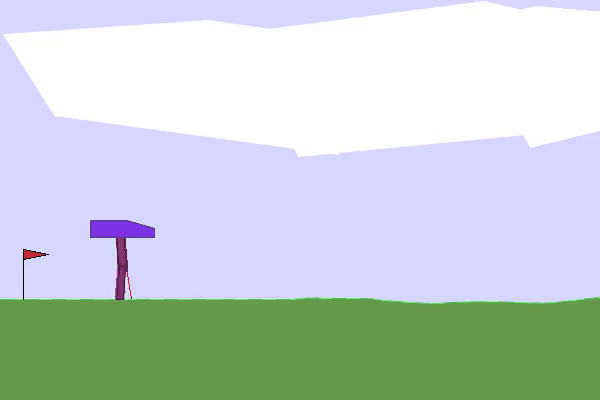

In [ ]:
mp4_to_gif("/content/videos/model_final-step-0-to-step-1000.mp4", "model_final.gif")
display_gif("/content/gif/model_final.gif")

## Modo hardcore

<img src="https://albarji-labs-materials.s3-eu-west-1.amazonaws.com/pro.png" height="80" width="80" style="float: right;"/>

***
<font color=#259b4c>
Este entorno dispone de un modo mucho más difícil en el que el terreno está plagado de escaleras, desniveles, fosas, ... este nivel de dificultad puede activarse indicando la opción <it>hardcore=True</it> al crear el entorno. ¡Inténtalo! ¿Qué nivel de recompensa logras conseguir?
</font>

***

Modelo 1: Modelo anterior

In [ ]:
# Creamos el ambiente
n_envs = 4
env_kwargs = {"hardcore": True}
vec_env_hardcore = make_vec_env("BipedalWalker-v3", n_envs=n_envs, seed=SEED, env_kwargs=env_kwargs)

In [ ]:
model_final_hardcore = PPO(
    policy="MlpPolicy",
    env=vec_env_hardcore,
    n_steps=2048,
    batch_size=32,
    gae_lambda=0.95,
    gamma=0.99,
    n_epochs=10,
    ent_coef=0.0,
    learning_rate=lambda f: 3e-4 * f,
    clip_range=0.2,
    vf_coef=0.5,
    max_grad_norm=0.5,
    verbose=1,
    tensorboard_log="./runs/",
    seed=SEED
)

  and should_run_async(code)



Using cpu device


In [ ]:
# Entrenamos el modelo
model_final_hardcore.learn(total_timesteps=1_000_000, log_interval = 10)

  and should_run_async(code)



Logging to ./runs/PPO_1
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 591         |
|    ep_rew_mean          | -108        |
| time/                   |             |
|    fps                  | 514         |
|    iterations           | 10          |
|    time_elapsed         | 159         |
|    total_timesteps      | 81920       |
| train/                  |             |
|    approx_kl            | 0.008627472 |
|    clip_fraction        | 0.0747      |
|    clip_range           | 0.2         |
|    entropy_loss         | -5.37       |
|    explained_variance   | 0.863       |
|    learning_rate        | 0.000278    |
|    loss                 | 3.07        |
|    n_updates            | 90          |
|    policy_gradient_loss | -0.00155    |
|    std                  | 0.924       |
|    value_loss           | 22.7        |
-----------------------------------------
-----------------------------------------
| rollout/

In [ ]:
# Evaluamos
mean_reward, std_reward = evaluate_policy(model_final_hardcore, vec_env_hardcore, n_eval_episodes=10)
print(f'Mean Reward: {mean_reward} +/- {std_reward}')

  and should_run_async(code)



Mean Reward: -52.5798312 +/- 42.365340695126456


In [ ]:
model_final_hardcore.save(os.path.join(log_dir, "ppo_bipedalwalker_hardcore"))


  and should_run_async(code)



# Modelo 2: Aumento de ambientes

In [ ]:
# Creamos el ambiente
n_envs = 32
vec_env_hardcore_2 = make_vec_env("BipedalWalker-v3", n_envs=n_envs, seed=SEED, env_kwargs=env_kwargs)

  and should_run_async(code)



In [ ]:
model_final_hardcore_2 = PPO(
    policy="MlpPolicy",
    env=vec_env_hardcore_2,
    n_steps=2048,
    batch_size=64,
    gae_lambda=0.95,
    gamma=0.999,
    n_epochs=10,
    ent_coef=0.0,
    learning_rate=lambda f: 3e-4 * f,
    clip_range=0.18,
    vf_coef=0.5,
    max_grad_norm=0.5,
    verbose=1,
    tensorboard_log="./runs/",
    seed=SEED
)

Using cpu device


In [ ]:
# Entrenamos el modelo
model_final_hardcore_2.learn(total_timesteps=1_000_000, log_interval = 10)

Logging to ./runs/PPO_3
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.06e+03    |
|    ep_rew_mean          | -110        |
| time/                   |             |
|    fps                  | 803         |
|    iterations           | 10          |
|    time_elapsed         | 815         |
|    total_timesteps      | 655360      |
| train/                  |             |
|    approx_kl            | 0.004645572 |
|    clip_fraction        | 0.0566      |
|    clip_range           | 0.18        |
|    entropy_loss         | -5.3        |
|    explained_variance   | 0.915       |
|    learning_rate        | 0.000123    |
|    loss                 | 4.56        |
|    n_updates            | 90          |
|    policy_gradient_loss | -0.00131    |
|    std                  | 0.909       |
|    value_loss           | 14.6        |
-----------------------------------------


In [ ]:
# Evaluamos
mean_reward, std_reward = evaluate_policy(model_final_hardcore_2, vec_env_hardcore, n_eval_episodes=10)
print(f'Mean Reward: {mean_reward} +/- {std_reward}')

  and should_run_async(code)



Mean Reward: -41.531564499999995 +/- 38.6854997181889


In [ ]:
# Creamos el ambiente
n_envs = 4
env_kwargs = {"hardcore": True}
vec_env_hardcore = make_vec_env("BipedalWalker-v3", n_envs=n_envs, seed=SEED, env_kwargs=env_kwargs)

  and should_run_async(code)



# Modelo 3: Mayor número de time-steps

In [ ]:
model_final_hardcore_3 = PPO(
    policy="MlpPolicy",
    env=vec_env_hardcore_2,
    n_steps=2048,
    batch_size=64,
    gae_lambda=0.95,
    gamma=0.999,
    n_epochs=10,
    ent_coef=0.0,
    learning_rate=lambda f: 3e-4 * f,
    clip_range=0.18,
    vf_coef=0.5,
    max_grad_norm=0.5,
    verbose=1,
    tensorboard_log="./runs/",
    seed=SEED
)

  and should_run_async(code)



Using cpu device


In [ ]:
# Entrenamos el modelo
model_final_hardcore_3.learn(total_timesteps=5_000_000, log_interval = 10)

Logging to ./runs/PPO_4
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.11e+03     |
|    ep_rew_mean          | -114         |
| time/                   |              |
|    fps                  | 839          |
|    iterations           | 10           |
|    time_elapsed         | 781          |
|    total_timesteps      | 655360       |
| train/                  |              |
|    approx_kl            | 0.0071131703 |
|    clip_fraction        | 0.0839       |
|    clip_range           | 0.18         |
|    entropy_loss         | -5.24        |
|    explained_variance   | 0.918        |
|    learning_rate        | 0.000265     |
|    loss                 | 3.41         |
|    n_updates            | 90           |
|    policy_gradient_loss | 0.000163     |
|    std                  | 0.892        |
|    value_loss           | 12.4         |
------------------------------------------
------------------------------

In [ ]:
# Evaluamos
mean_reward, std_reward = evaluate_policy(model_final_hardcore_3, vec_env_hardcore, n_eval_episodes=10)
print(f'Mean Reward: {mean_reward} +/- {std_reward}')